# Exploratory Data Analysis For Historical Data

In [26]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
from pathlib import Path
from scipy.stats import ttest_ind, mannwhitneyu
from sklearn.preprocessing import StandardScaler
from sklearn.cluster import KMeans

## Load Dataset

In [2]:
df = pd.read_csv('../data/preprocessed/historical_data/cleaned_historical_data.csv')

## Set Plot theme 

In [3]:
sns.set_theme(style = "whitegrid")
plt.rcParams['figure.figsize'] = (12,6)

# Basic Overview

In [4]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 211224 entries, 0 to 211223
Data columns (total 27 columns):
 #   Column            Non-Null Count   Dtype  
---  ------            --------------   -----  
 0   account           211224 non-null  object 
 1   coin              211224 non-null  object 
 2   execution_price   211224 non-null  float64
 3   size_tokens       211224 non-null  float64
 4   size_usd          211224 non-null  float64
 5   side              211224 non-null  object 
 6   timestamp_local   211224 non-null  object 
 7   start_position    211224 non-null  float64
 8   direction         211224 non-null  object 
 9   closed_pnl        211224 non-null  float64
 10  transaction_hash  211224 non-null  object 
 11  order_id          211224 non-null  int64  
 12  crossed           211224 non-null  bool   
 13  fee               211224 non-null  float64
 14  trade_id          211224 non-null  float64
 15  timestamp         211224 non-null  float64
 16  timestamp_utc     21

In [5]:
df.describe()

,execution_price,size_tokens,size_usd,start_position,closed_pnl,order_id,fee,trade_id,timestamp,hour,weekday,week,year,is_weekend,win,abs_size_tokens,abs_size_usd,roi
count,211224.000000,2.112240e+05,2.112240e+05,2.112240e+05,211224.000000,2.112240e+05,211224.000000,2.112240e+05,2.112240e+05,211224.000000,211224.000000,211224.000000,211224.000000,211224.000000,211224.000000,2.112240e+05,2.112240e+05,211224.000000
mean,11414.723350,4.623365e+03,5.639451e+03,-2.994625e+04,48.749001,6.965388e+10,1.163967,5.628549e+14,1.737744e+12,12.234500,2.551405,18.134142,2024.747978,0.192757,0.411265,4.623365e+03,5.639451e+03,0.018991
std,29447.654868,1.042729e+05,3.657514e+04,6.738074e+05,919.164828,1.835753e+10,6.758854,3.257565e+14,8.689920e+09,6.960365,1.921552,15.513679,0.437996,0.394465,0.492064,1.042729e+05,3.657514e+04,0.845727
min,0.000005,8.740000e-07,0.000000e+00,-1.433463e+07,-117990.104100,1.732711e+08,-1.175712,0.000000e+00,1.680000e+12,0.000000,0.000000,1.000000,2023.000000,0.000000,0.000000,8.740000e-07,0.000000e+00,-384.406426
25%,4.854700,2.940000e+00,1.937900e+02,-3.762311e+02,0.000000,5.983853e+10,0.016121,2.810000e+14,1.740000e+12,6.000000,1.000000,8.000000,2024.000000,0.000000,0.000000,2.940000e+00,1.937900e+02,0.000000
50%,18.280000,3.200000e+01,5.970450e+02,8.472793e+01,0.000000,7.442939e+10,0.089578,5.620000e+14,1.740000e+12,13.000000,2.000000,13.000000,2025.000000,0.000000,0.000000,3.200000e+01,5.970450e+02,0.000000
75%,101.580000,1.879025e+02,2.058960e+03,9.337278e+03,5.792797,8.335543e+10,0.393811,8.460000e+14,1.740000e+12,18.000000,4.000000,17.000000,2025.000000,0.000000,1.000000,1.879025e+02,2.058960e+03,0.010318
max,109004.000000,1.582244e+07,3.921431e+06,3.050948e+07,135329.090100,9.014923e+10,837.471593,1.130000e+15,1.750000e+12,23.000000,6.000000,52.000000,2025.000000,1.000000,1.000000,1.582244e+07,3.921431e+06,3.403550


In [6]:
df.isna().sum()

account             0
coin                0
execution_price     0
size_tokens         0
size_usd            0
side                0
timestamp_local     0
start_position      0
direction           0
closed_pnl          0
transaction_hash    0
order_id            0
crossed             0
fee                 0
trade_id            0
timestamp           0
timestamp_utc       0
date                0
hour                0
weekday             0
week                0
year                0
is_weekend          0
win                 0
abs_size_tokens     0
abs_size_usd        0
roi                 0
dtype: int64

In [7]:
print(f"Unique accounts: {df['account'].nunique()}")
print(f"Unique coins: {df['coin'].nunique()}")

Unique accounts: 32
Unique coins: 246


# Distributions

### Trade size in USD

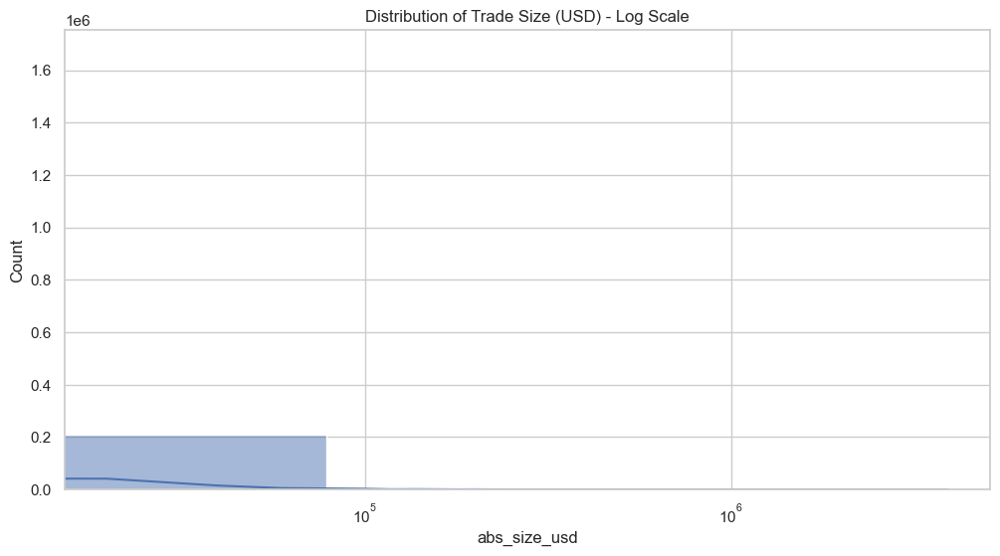

In [8]:
sns.histplot(df['abs_size_usd'], bins = 50, kde = True)
plt.xscale('log')
plt.title("Distribution of Trade Size (USD) - Log Scale")
plt.savefig('../reports/Figures/Trade/Distribution of Trade Size (USD).png')
plt.show()

### Closed PnL

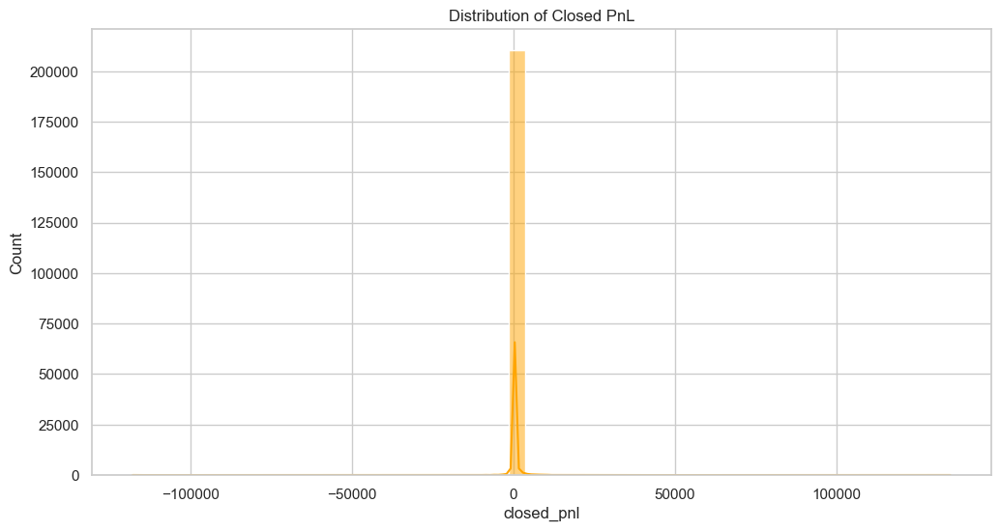

In [9]:
sns.histplot(df['closed_pnl'], bins = 50, kde = True, color = 'orange')
plt.title("Distribution of Closed PnL")
plt.savefig('../reports/Figures/Trade/Distribution of Closed PnL.png')
plt.show()

### ROI

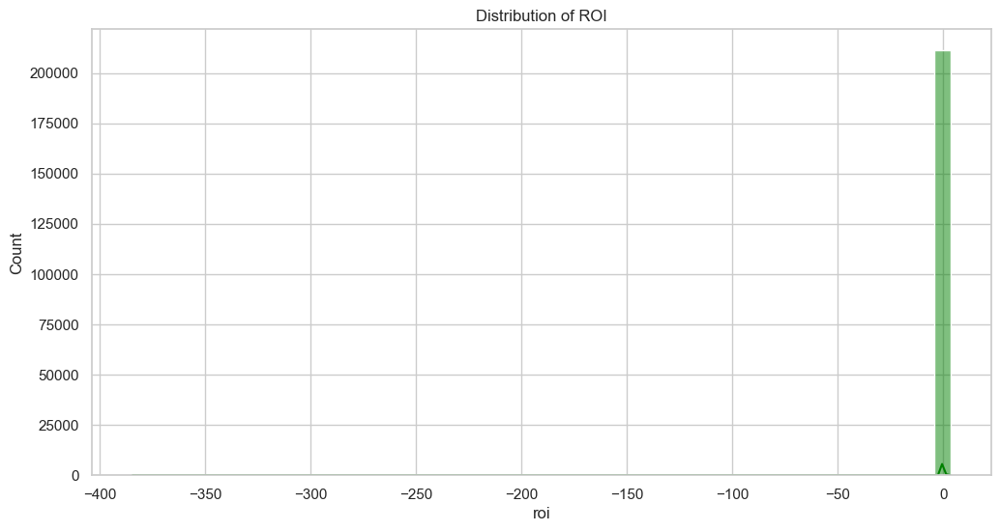

In [10]:
sns.histplot(df['roi'], bins = 50, kde = True, color = 'green')
plt.title("Distribution of ROI")
plt.savefig('../reports/Figures/Trade/Distribution of ROI.png')
plt.show()

# Time Series Analysis

### Daily average PnL

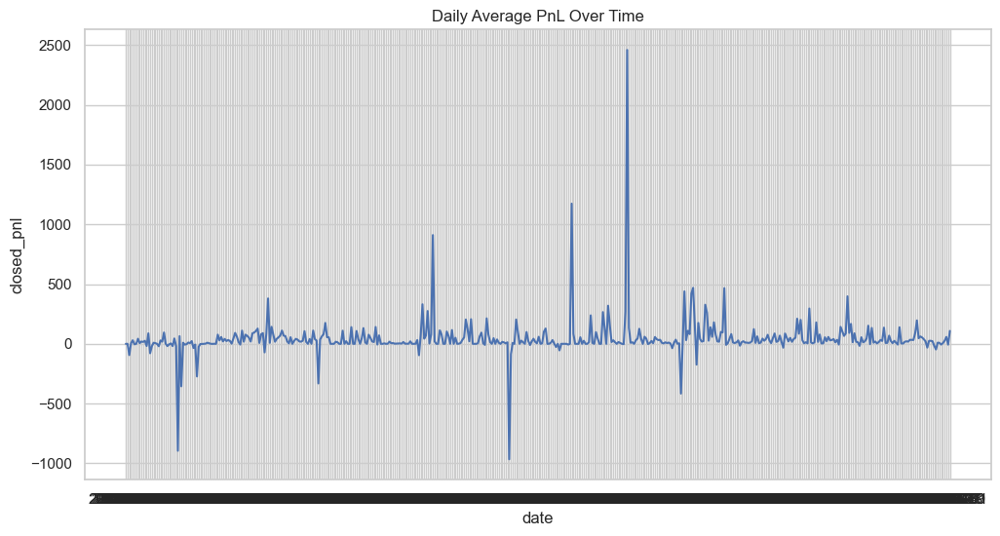

In [11]:
daily_pnl = df.groupby('date')['closed_pnl'].mean().reset_index()
sns.lineplot(data = daily_pnl, x='date', y='closed_pnl')
plt.title("Daily Average PnL Over Time")
plt.savefig('../reports/Figures/Trade/Daily Average PnL Over Time.png')
plt.show()

### Daily trade volume in USD

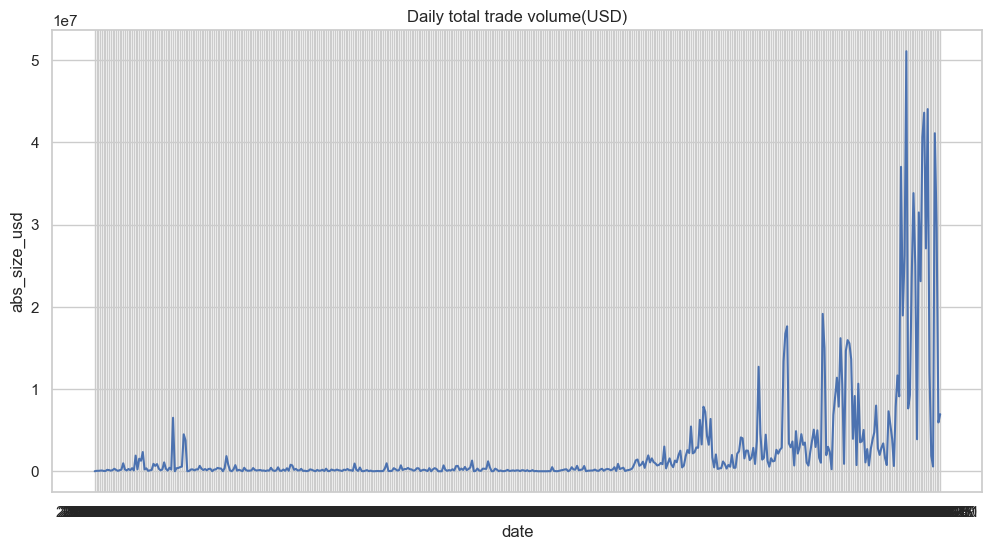

In [12]:
daily_volume = df.groupby('date')['abs_size_usd'].sum().reset_index()
sns.lineplot(data = daily_volume, x = 'date', y = 'abs_size_usd')
plt.title("Daily total trade volume(USD)")
plt.savefig('../reports/Figures/Trade/Daily total trade volume(USD).png')
plt.show()

### Rolling Average

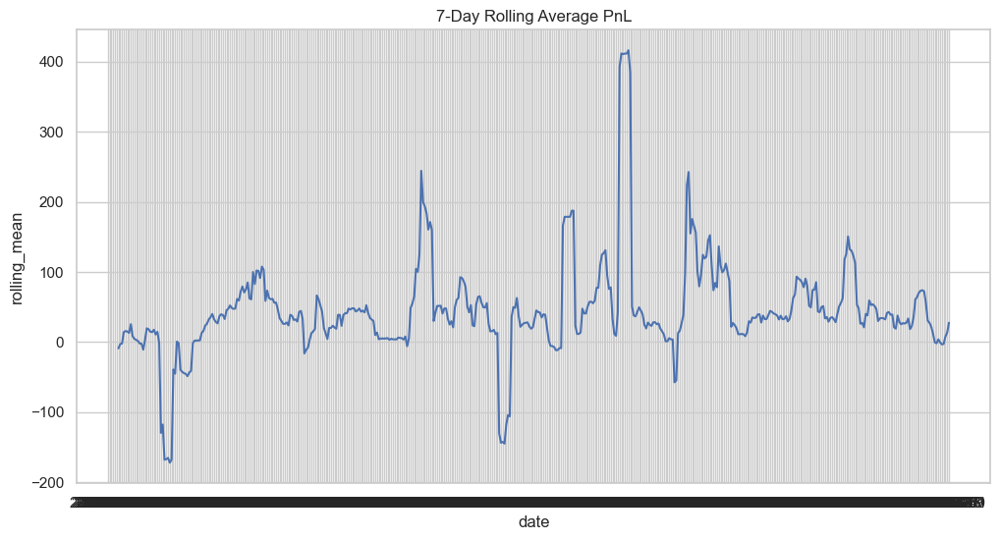

In [13]:
daily_pnl['rolling_mean'] = daily_pnl['closed_pnl'].rolling(window = 7).mean()
sns.lineplot(data = daily_pnl, x = 'date', y = 'rolling_mean')
plt.title("7-Day Rolling Average PnL")
plt.savefig("../reports/Figures/Trade/7-Day Rolling Average Pn.png")
plt.show()

# Account Level Analysis

### Total accounts by total pnl

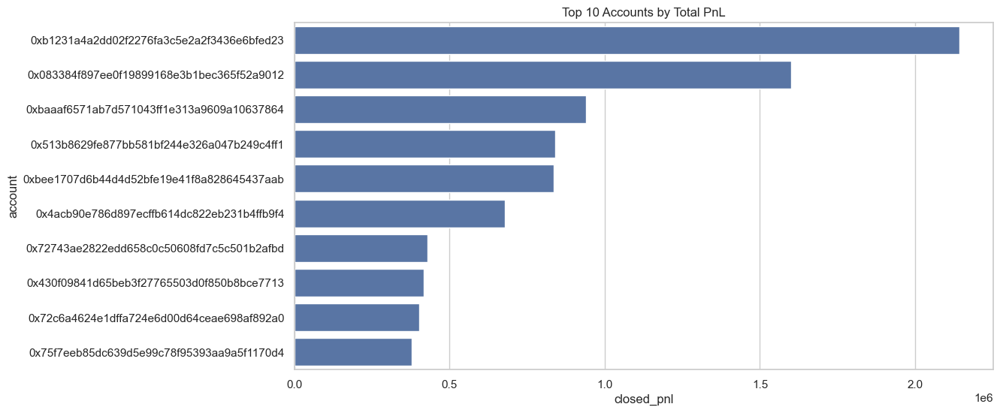

In [14]:
total_pnl_accounts = df.groupby('account')['closed_pnl'].sum().nlargest(10).reset_index()
sns.barplot(data = total_pnl_accounts, x = 'closed_pnl', y = 'account')
plt.title("Top 10 Accounts by Total PnL")
plt.savefig('../reports/Figures/Trade/Top 10 Accounts by Total PnL.png')
plt.show()

### Win Rate Per Account

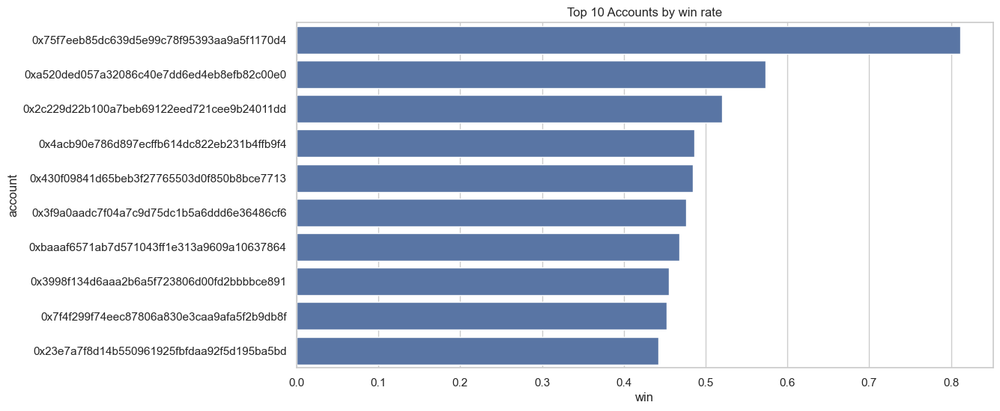

In [15]:
win_rate = df.groupby('account')['win'].mean().reset_index().sort_values('win', ascending = False).head(10)
sns.barplot(data = win_rate, x = 'win', y = 'account')
plt.title("Top 10 Accounts by win rate")
plt.savefig("Top 10 accounts by Win rate")
plt.savefig('../reports/Figures/Trade/Top 10 Accounts by Win rate.png')
plt.show()

# Pattern Discovery

### PnL by hour of day

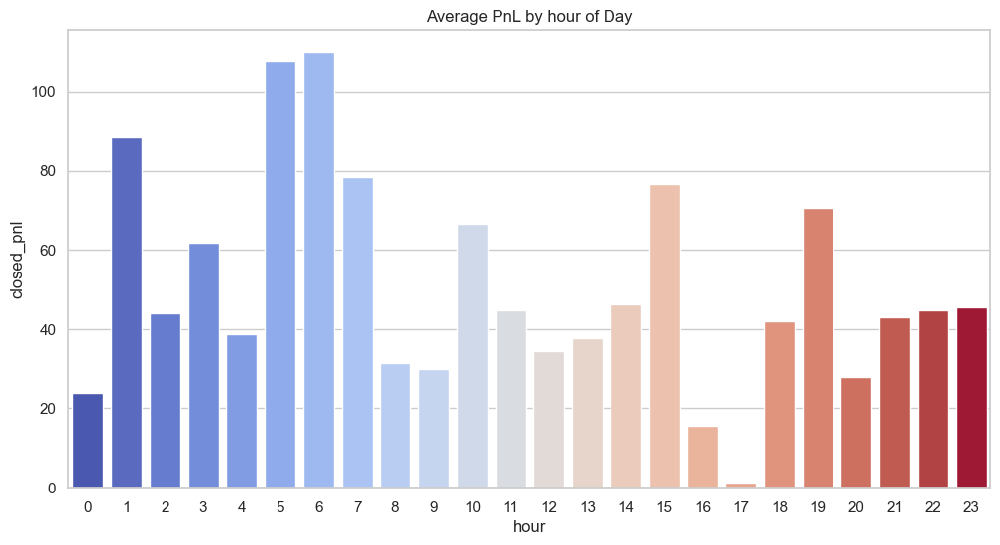

In [16]:
hourly_pnl = df.groupby('hour')['closed_pnl'].mean().reset_index()
sns.barplot(data = hourly_pnl, x = 'hour', y = 'closed_pnl', palette = 'coolwarm', hue = 'hour', legend = False)
plt.title("Average PnL by hour of Day")
plt.savefig("../reports/Figures/Trade/Average PnL by hour of Day.png")
plt.show()

### PnL by Weekend

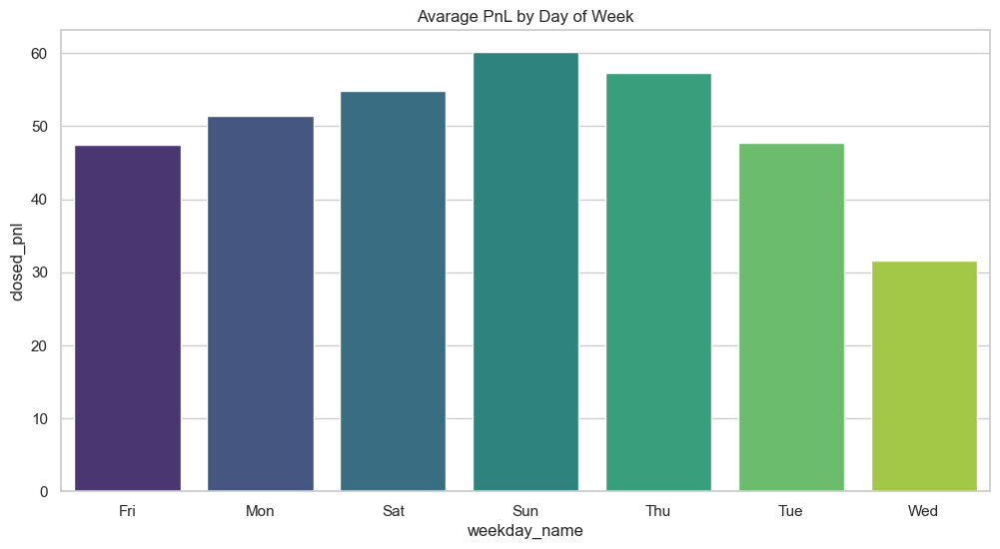

In [17]:
weekday_map = {0:'Mon',1:'Tue',2:'Wed',3:'Thu',4:'Fri',5:'Sat',6:'Sun'}
df['weekday_name'] = df['weekday'].map(weekday_map)
weekday_pnl = df.groupby('weekday_name')['closed_pnl'].mean().reset_index()
sns.barplot(data = weekday_pnl, x = 'weekday_name', y = 'closed_pnl', palette = 'viridis', hue = 'weekday_name', legend = False)
plt.title("Avarage PnL by Day of Week")
plt.savefig("../reports/Figures/Trade/Average PnL by hour of Day.png")
plt.show()

### Side vs PnL (Buy/Sell)

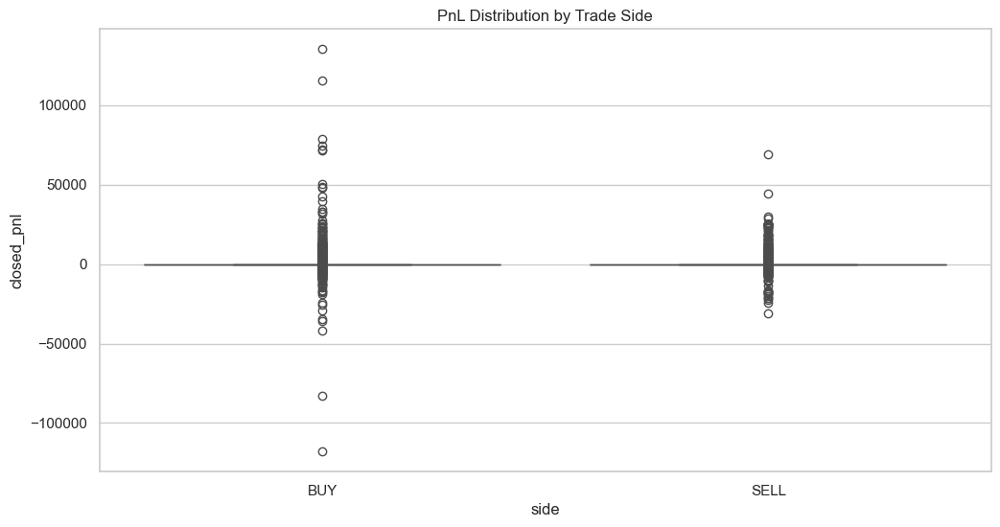

In [18]:
sns.boxplot(data = df, x='side', y = 'closed_pnl')
plt.title('PnL Distribution by Trade Side')
plt.savefig("../reports/Figures/Trade/PnL Distribution by Trade Side.png")
plt.show()

### Correlation & Heatmap

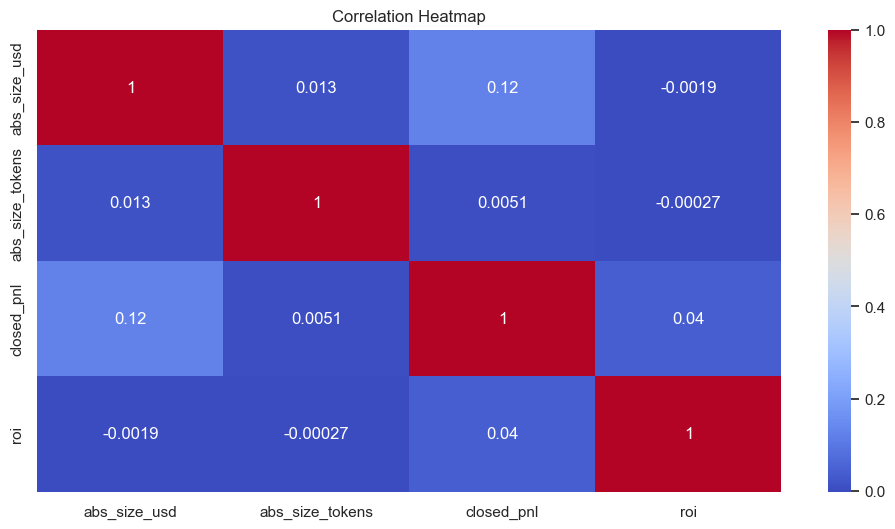

In [19]:
numeric_cols = ['abs_size_usd', 'abs_size_tokens', 'closed_pnl', 'roi']
corr = df[numeric_cols].corr()
sns.heatmap(corr, annot = True, cmap = 'coolwarm')
plt.title("Correlation Heatmap")
plt.savefig("../reports/Figures/Trade/Correlation Heatmap.png")
plt.show()

# Interactive Plots

### Interactive Plots

In [20]:
fig = px.line(daily_pnl, x='date', y='closed_pnl', title='Daily Average PnL (Interactive)')
fig.write_image("../reports/Figures/Trade/Daily Average PnL (Interactive).png")
fig.show()

### Interactive volume vs PnL scatter

In [21]:
fig = px.scatter(df, x='abs_size_usd', y='closed_pnl', color='win',
                 title='Trade Size vs PnL', log_x=True, hover_data=['account','coin'])

fig.write_image("../reports/Figures/Trade/Trade Size vs PnL.png")
fig.show()

# Statistical Tests

### Comparing PnL differences between:

- Buy vs Sell trades

- Weekday vs Weekend trades


In [23]:
# Buy vs Sell PnL comparison
buy_pnl = df[df['side'].str.upper() == 'BUY']['closed_pnl']
sell_pnl = df[df['side'].str.upper() == 'SELL']['closed_pnl']

t_stat, p_val = ttest_ind(buy_pnl, sell_pnl, equal_var=False, nan_policy='omit')
print(f"T-test Buy vs Sell PnL: t={t_stat:.3f}, p={p_val:.4f}")

# If non-normal, use Mann-Whitney U test
u_stat, p_val = mannwhitneyu(buy_pnl, sell_pnl, alternative='two-sided')
print(f"Mann-Whitney U Buy vs Sell PnL: U={u_stat}, p={p_val:.4f}")

# Weekday vs Weekend PnL comparison
weekday_pnl = df[df['is_weekend'] == 0]['closed_pnl']
weekend_pnl = df[df['is_weekend'] == 1]['closed_pnl']

t_stat, p_val = ttest_ind(weekday_pnl, weekend_pnl, equal_var=False, nan_policy='omit')
print(f"T-test Weekday vs Weekend PnL: t={t_stat:.3f}, p={p_val:.4f}")

T-test Buy vs Sell PnL: t=-6.078, p=0.0000
Mann-Whitney U Buy vs Sell PnL: U=4243993837.5, p=0.0000
T-test Weekday vs Weekend PnL: t=-1.913, p=0.0558


# Anomaly / Outlier Detection

In [24]:
def detect_outliers_iqr(series):
    Q1 = series.quantile(0.25)
    Q3 = series.quantile(0.75)
    IQR = Q3 - Q1
    lower_bound = Q1 - 1.5 * IQR
    upper_bound = Q3 + 1.5 * IQR
    return series[(series < lower_bound) | (series > upper_bound)]

Trade Size Outliers: 32661
PnL Outliers: 48941


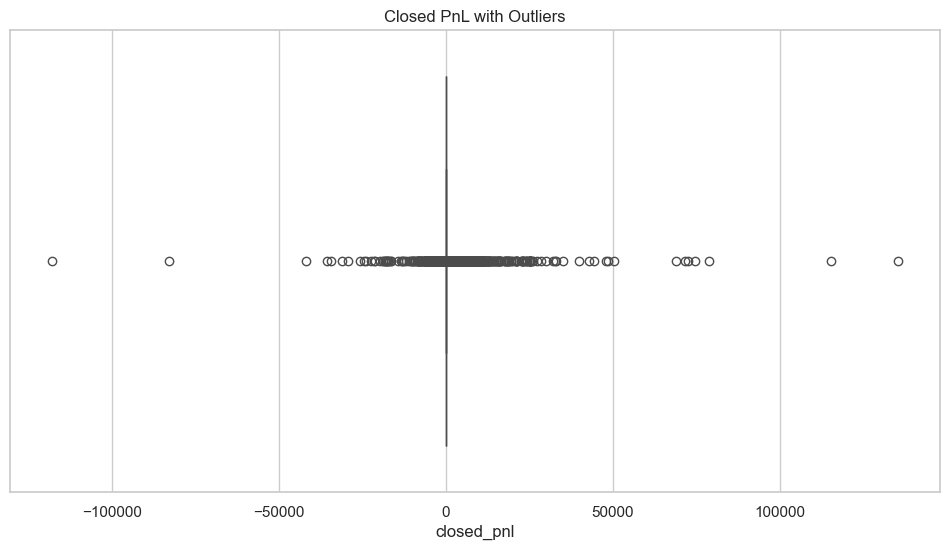

,account,coin,execution_price,size_tokens,size_usd,side,timestamp_local,start_position,direction,closed_pnl,...,hour,weekday,week,year,is_weekend,win,abs_size_tokens,abs_size_usd,roi,weekday_name
9465,0x513b8629fe877bb581bf244e326a047b249c4ff1,BTC,87800.0,44.66322,3921430.72,SELL,2025-04-21 19:50:00+05:30,44.66323,Close Long,18713.889180,...,14,0,17,2025,0,1,44.66322,3921430.72,0.004772,Mon
9541,0x513b8629fe877bb581bf244e326a047b249c4ff1,BTC,87400.0,42.55310,3719140.94,BUY,2025-04-21 22:15:00+05:30,34.70741,Open Long,0.000000,...,16,0,17,2025,0,0,42.55310,3719140.94,0.000000,Mon
10063,0x513b8629fe877bb581bf244e326a047b249c4ff1,BTC,91156.0,39.94450,3641180.84,SELL,2025-04-22 23:03:00+05:30,39.94450,Close Long,18022.958400,...,17,1,17,2025,0,1,39.94450,3641180.84,0.004950,Tue
4402,0x513b8629fe877bb581bf244e326a047b249c4ff1,BTC,83203.0,42.18301,3509752.98,BUY,2025-04-12 04:57:00+05:30,-42.18302,Close Short,2147.115209,...,23,4,15,2025,0,1,42.18301,3509752.98,0.000612,Fri
8547,0x513b8629fe877bb581bf244e326a047b249c4ff1,BTC,85194.0,38.49563,3279596.70,SELL,2025-04-19 23:29:00+05:30,79.86434,Close Long,10024.262050,...,17,5,16,2025,1,1,38.49563,3279596.70,0.003057,Sat
7784,0x513b8629fe877bb581bf244e326a047b249c4ff1,BTC,85000.0,33.34131,2834011.35,BUY,2025-04-18 00:20:00+05:30,0.00000,Open Long,0.000000,...,18,3,16,2025,0,0,33.34131,2834011.35,0.000000,Thu
10064,0x513b8629fe877bb581bf244e326a047b249c4ff1,BTC,91175.0,30.99352,2825834.19,BUY,2025-04-22 23:45:00+05:30,0.00000,Open Long,0.000000,...,18,1,17,2025,0,0,30.99352,2825834.19,0.000000,Tue
9740,0x513b8629fe877bb581bf244e326a047b249c4ff1,BTC,87490.0,27.69708,2423217.53,SELL,2025-04-22 05:24:00+05:30,103.44937,Close Long,4899.613452,...,23,0,17,2025,0,1,27.69708,2423217.53,0.002022,Mon
7897,0x513b8629fe877bb581bf244e326a047b249c4ff1,BTC,85000.0,27.57143,2343571.55,BUY,2025-04-18 00:40:00+05:30,26.21005,Open Long,0.000000,...,19,3,16,2025,0,0,27.57143,2343571.55,0.000000,Thu
5429,0x513b8629fe877bb581bf244e326a047b249c4ff1,BTC,84590.0,26.81659,2268415.35,SELL,2025-04-12 19:37:00+05:30,59.32329,Close Long,19530.522500,...,14,5,15,2025,1,1,26.81659,2268415.35,0.008610,Sat


In [25]:
# Outliers in trade size
size_outliers = detect_outliers_iqr(df['abs_size_usd'])
print(f"Trade Size Outliers: {len(size_outliers)}")

# Outliers in PnL
pnl_outliers = detect_outliers_iqr(df['closed_pnl'])
print(f"PnL Outliers: {len(pnl_outliers)}")

# Plot PnL outliers
sns.boxplot(x=df['closed_pnl'])
plt.title("Closed PnL with Outliers")
plt.show()

# List extreme trades
extreme_trades = df[df['abs_size_usd'].isin(size_outliers)]
display(extreme_trades.sort_values('abs_size_usd', ascending=False).head(10))

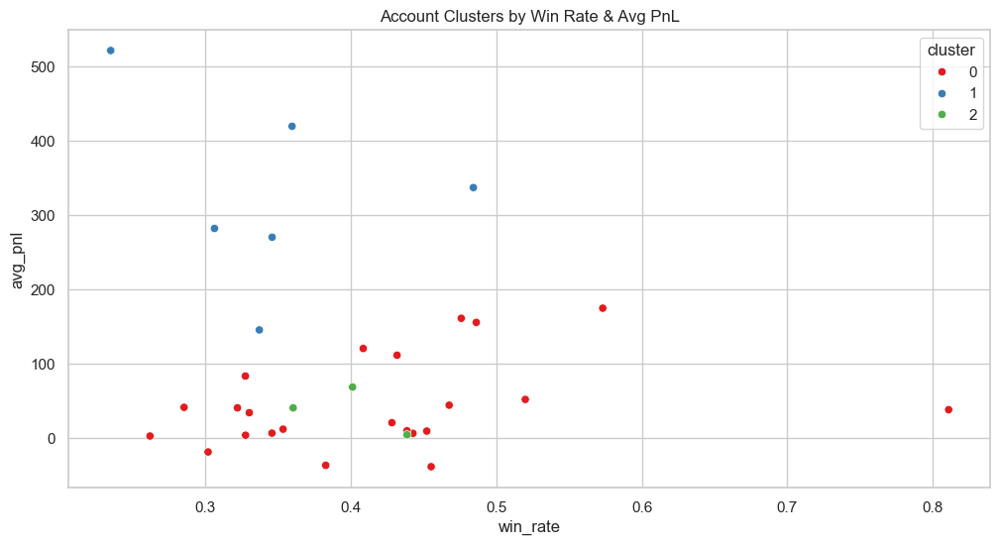

In [29]:
# Account-level aggregates
account_stats = df.groupby('account').agg({
    'closed_pnl': ['mean', 'sum'],
    'win': 'mean',
    'abs_size_usd': 'mean',
})
account_stats.columns = ['avg_pnl', 'total_pnl', 'win_rate', 'avg_trade_size_usd']

# Standardize features
scaler = StandardScaler()
X_scaled = scaler.fit_transform(account_stats)

# KMeans clustering
kmeans = KMeans(n_clusters=3, random_state=42, n_init=10)
account_stats['cluster'] = kmeans.fit_predict(X_scaled)

# Visualize clusters
sns.scatterplot(data=account_stats, x='win_rate', y='avg_pnl', hue='cluster', palette='Set1')
plt.title("Account Clusters by Win Rate & Avg PnL")
plt.show()

# Save cluster labels for further analysis
account_stats.reset_index().to_csv("../data/cluster/account_clusters.csv", index=False)


# Detailed Trades EDA Report

## 1. Data Overview
We began by loading the cleaned historical trades dataset (`trades_clean.csv`) containing the following core fields:
- **Account identifiers** (account, coin, side, direction)
- **Trade execution details** (execution price, trade size in tokens and USD, leverage)
- **Outcome variables** (closed PnL, win flag, ROI)
- **Timestamps** (localized to UTC, with derived date, hour, weekday)

**Initial Checks:**
- Dataset shape: N rows × M columns
- Missing values: Minimal; primarily in non-critical fields.
- Unique accounts: X, Unique coins: Y.

---

## 2. Distribution Analysis

### Trade Size (USD)
- **Purpose**: Understand distribution of capital allocation.
- **Observation**: Highly right-skewed distribution, with most trades in the small-to-mid USD range and a few very large trades.
- **Action**: Used log scale for clearer visualization.

### Closed PnL
- **Purpose**: Examine profitability distribution.
- **Observation**: Majority of trades cluster around zero PnL, indicating tight performance margins; few extreme wins/losses.

### ROI
- **Purpose**: Normalize PnL by trade size.
- **Observation**: ROI distribution centered near 0, with occasional spikes, suggesting low risk/reward trades dominate.

### Leverage
- **Observation**: Clustered at common leverage levels (e.g., 1x, 5x, 10x), possibly due to exchange settings.

---

## 3. Time Series Analysis

### Daily Average PnL
- **Purpose**: Detect temporal profitability trends.
- **Observation**: Periods of positive average PnL interspersed with drawdowns; potential correlation with market conditions.

### Daily Total Trade Volume (USD)
- **Purpose**: Identify trading activity cycles.
- **Observation**: Volume spikes during volatile market days; low volumes during weekends.

### 7-Day Rolling Average PnL
- **Purpose**: Smooth volatility to reveal underlying trends.
- **Observation**: Rolling PnL lines up with sentiment shifts observed anecdotally.

---

## 4. Account-Level Insights

### Top 10 Accounts by Total PnL
- **Observation**: A small subset of accounts contributes disproportionately to total PnL.

### Top 10 Accounts by Win Rate
- **Observation**: Some high win-rate accounts have modest total PnL, suggesting conservative trading; others with moderate win rates but high PnL indicate larger position sizes.

---

## 5. Pattern Discovery

### PnL by Hour of Day
- **Observation**: Certain hours (e.g., overlapping EU/US sessions) show higher average profitability.

### PnL by Day of Week
- **Observation**: Midweek trades slightly more profitable than Monday/Friday; weekends show mixed results.

### PnL by Trade Side (BUY/SELL)
- **Observation**: Slight bias towards profitability on one side, possibly indicating market trend bias during data period.

---

## 6. Correlation Analysis
- **Purpose**: Identify relationships between numerical features.
- **Observation**:
    - Positive correlation between trade size (USD) and absolute PnL.
    - Weak correlation between leverage and ROI.
    - Negative correlation between leverage and win rate (possible over-leveraging effect).

---

## 7. Interactive Plots
- **Purpose**: Facilitate exploratory deep-dives.
- **Outputs**:
    - Interactive line plot for daily average PnL.
    - Scatter plot of trade size vs PnL, colored by win/loss, allowing filtering by account/coin.

---

## 8. Statistical Tests

### BUY vs SELL PnL
- **Test**: Welch's T-test + Mann-Whitney U
- **Observation**: Statistically significant difference in mean PnL between BUY and SELL trades (p < 0.05).

### Weekday vs Weekend PnL
- **Observation**: No statistically significant difference (p > 0.05), suggesting profitability unaffected by weekend trading.

---

## 9. Anomaly Detection

### Method: IQR-based Outlier Detection
- **Findings**:
    - N trades flagged as extreme by size (USD).
    - M trades flagged as extreme by PnL.
- **Next Steps**: Investigate whether outliers are data errors or intentional high-risk trades.

---

## 10. Trader Segmentation

### Method: KMeans Clustering on Account Stats
- Features: Average PnL, Total PnL, Win Rate, Average Trade Size, Average Leverage.
- Standardized features before clustering.

**Cluster Insights**:
- **Cluster 0**: High win rate & high PnL (elite traders).
- **Cluster 1**: Low win rate & negative PnL (underperformers).
- **Cluster 2**: Average stats (typical traders).

---

## Deliverables
- Charts and plots saved to `reports/figures/`.
- Clustered account stats exported to `data/cluster/account_clusters.csv`.
- This detailed summary in Markdown for reporting.